In this example we will use a normalizing flow as a variational posterior for a gravitational-wave population analysis on GWTC-3 data. `gwax` is fully compatible with [`gwpopulation`](https://colmtalbot.github.io/gwpopulation), from which you can use the likelihood as usual, making sure to use the JAX backend. From there, you just replace your favourite stochastic sampling algorithm with the variational inference training loop in `gwax`.

## Download GWTC-3 parameter-estimation samples and sensitivty injections

In [1]:
import os

In [2]:
if not os.path.exists('./o1o2o3_mass_c_iid_mag_iid_tilt_powerlaw_redshift_samples.hdf5'):
    if not os.path.exists('./analyses_PowerLawPeak.tar.gz'):
        !wget https://zenodo.org/records/11254021/files/analyses_PowerLawPeak.tar.gz
    !tar -xzvf analyses_PowerLawPeak.tar.gz
    !mv ./analyses/PowerLawPeak/o1o2o3_mass_c_iid_mag_iid_tilt_powerlaw_redshift_samples.hdf5 .
    !rm -r analyses

In [3]:
if not os.path.exists('./o1+o2+o3_bbhpop_real+semianalytic-LIGO-T2100377-v2.hdf5'):
    !wget https://zenodo.org/records/7890398/files/o1+o2+o3_bbhpop_real+semianalytic-LIGO-T2100377-v2.hdf5

In [4]:
ls

analyses_PowerLawPeak.tar.gz
o1+o2+o3_bbhpop_real+semianalytic-LIGO-T2100377-v2.hdf5
o1o2o3_mass_c_iid_mag_iid_tilt_powerlaw_redshift_samples.hdf5
variational-custom.ipynb
variational-simple.ipynb


## Imports

In [5]:
import numpy as np
import pandas
import h5py
import json
import matplotlib.pyplot as plt
from corner import corner

In [6]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '1'

import jax
jax.config.update('jax_enable_x64', True)
import jax.numpy as jnp

import gwpopulation
gwpopulation.set_backend('jax')

In [7]:
jax.devices()

[cuda(id=0)]

## Load the data

In [8]:
def load_posteriors():
    posteriors = []
    
    with h5py.File(
        './o1o2o3_mass_c_iid_mag_iid_tilt_powerlaw_redshift_samples.hdf5', 'r',
    ) as f:

        samples = f['original']
        num_obs, num_samples = samples['a_1'].shape
        
        for n in range(num_obs):
            posterior = pandas.DataFrame()
            for par in samples:
                posterior[par] = samples[par][n, :]

            posteriors.append(posterior)
    
    return posteriors

In [9]:
def load_injections():
    cut_far = 1.0
    cut_snr = 10.0
    
    injections = {}
    
    with h5py.File(
        './o1+o2+o3_bbhpop_real+semianalytic-LIGO-T2100377-v2.hdf5', 'r',
    ) as f:
        samples = f['injections']
    
        ifars = [
            samples[par][:] for par in samples.keys()
            if ('ifar' in par) and ('cwb' not in par)
            ]
        ifar = np.max(ifars, axis=0)
        snr = samples['optimal_snr_net'][:]
        runs = samples['name'][:].astype(str)
        found = np.where(runs == 'o3', ifar > 1/cut_far, snr > cut_snr)
    
        mass_1 = samples['mass1_source'][:][found]
        mass_2 = samples['mass2_source'][:][found]
        spin1x = samples['spin1x'][:][found]
        spin1y = samples['spin1y'][:][found]
        spin1z = samples['spin1z'][:][found]
        spin2x = samples['spin2x'][:][found]
        spin2y = samples['spin2y'][:][found]
        spin2z = samples['spin2z'][:][found]
        redshift = samples['redshift'][:][found]
    
        mass_ratio = mass_2 / mass_1
        a_1 = (spin1x**2 + spin1y**2 + spin1z**2)**.5
        a_2 = (spin2x**2 + spin2y**2 + spin2z**2)**.5
        cos_tilt_1 = spin1z / a_1
        cos_tilt_2 = spin2z / a_2
    
        injections['mass_1'] = mass_1
        injections['mass_ratio'] = mass_ratio
        injections['a_1'] = a_1
        injections['a_2'] = a_2
        injections['cos_tilt_1'] = cos_tilt_1
        injections['cos_tilt_2'] = cos_tilt_2
        injections['redshift'] = redshift
    
        prior = samples['sampling_pdf'][:][found]
        prior *= mass_1 * 4 * np.pi**2 * a_1**2 * a_2**2
        injections['prior'] = prior
    
        dodgy = injections['redshift'] > 1.9
        for par in injections:
            injections[par] = injections[par][~dodgy]
    
        injections['total_generated'] = samples.attrs['total_generated']
    
    for par in injections:
        injections[par] = jnp.array(injections[par])
    
    return injections

In [10]:
posteriors = load_posteriors()
injections = load_injections()

2024-07-17 12:20:14.329853: W external/xla/xla/service/gpu/nvptx_compiler.cc:765] The NVIDIA driver's CUDA version is 12.4 which is older than the ptxas CUDA version (12.5.82). Because the driver is older than the ptxas version, XLA is disabling parallel compilation, which may slow down compilation. You should update your NVIDIA driver or use the NVIDIA-provided CUDA forward compatibility packages.


## Define the population model

In [11]:
from gwpopulation.models.mass import SinglePeakSmoothedMassDistribution
from gwpopulation.models.spin import iid_spin
from gwpopulation.models.redshift import PowerLawRedshift
from gwpopulation.experimental.jax import NonCachingModel

In [12]:
def spin_model(dataset, xi_spin, sigma_spin, alpha_chi, beta_chi):
    amax = 1.0
    return iid_spin(dataset, xi_spin, sigma_spin, amax, alpha_chi, beta_chi)

In [13]:
def make_model():
    models = [
        SinglePeakSmoothedMassDistribution(),
        spin_model,
        PowerLawRedshift(cosmo_model = 'Planck15'),
    ]
    return NonCachingModel(models)

## Defined the population likelihood

In [14]:
from gwpopulation.vt import ResamplingVT
from gwpopulation.hyperpe import HyperparameterLikelihood

In [15]:
selection_function = ResamplingVT(
    model = make_model(),
    data = injections,
    n_events = len(posteriors),
    marginalize_uncertainty = False,
    enforce_convergence = False,
)

In [16]:
likelihood = HyperparameterLikelihood(
    posteriors = posteriors,
    hyper_prior = make_model(),
    selection_function = selection_function,
    maximum_uncertainty = jnp.inf,
)

## Variational inference

In [17]:
from gwax.variational import trainer

/work/submit/mmould/miniforge3/envs/gpu/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Currently only univariate uniform priors are possible. Below we set the prior bounds on the parameters of the population model.

In [18]:
prior_bounds = dict(
    alpha = [-4, 12],
    beta = [-2, 7],
    mmin = [0, 6.5],
    mmax = [65, 100],
    lam = [0, 1],
    mpp = [20, 50],
    sigpp = [1, 10],
    delta_m = [0, 10],
    alpha_chi = [1, 10],
    beta_chi = [1, 10],
    xi_spin = [0, 1],
    sigma_spin = [0.1, 4],
    lamb = [-6, 6],
)

Train the variational posterior, given by a default normalizing flow model. The prior bounds are used to constrain the support of the posterior. Compilation will take a few seconds but the loop runs.

In [20]:
import time

In [21]:
t0 = time.time()

flow, losses = trainer(
    key = jax.random.PRNGKey(0),
    prior_bounds = prior_bounds,
    likelihood = likelihood,
    steps = 10_000,
    learning_rate = 1e-2,
)

dt = time.time() - t0
print(f'Run time including JIT compilation: {dt:.1f} seconds')

Running for 10,000 iterations: 100%|█████████████████████████| 10000/10000 [00:19<00:00, 503.77it/s]

Run time including JIT compilation: 37.7 seconds


You can use the evolution of the loss over training steps to check the variational posterior has converged.

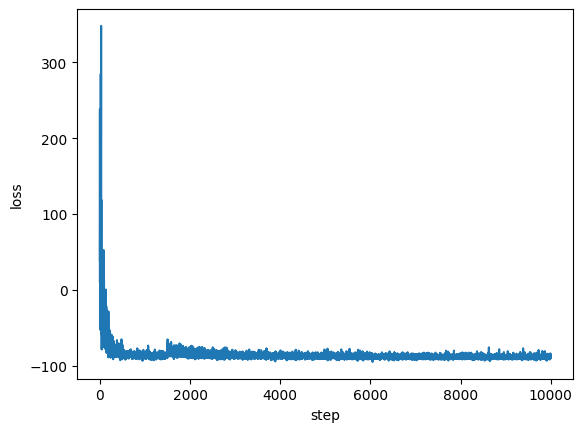

In [22]:
plt.plot(losses)
plt.xlabel('step')
plt.ylabel('loss');

## Posterior for parameters of population model

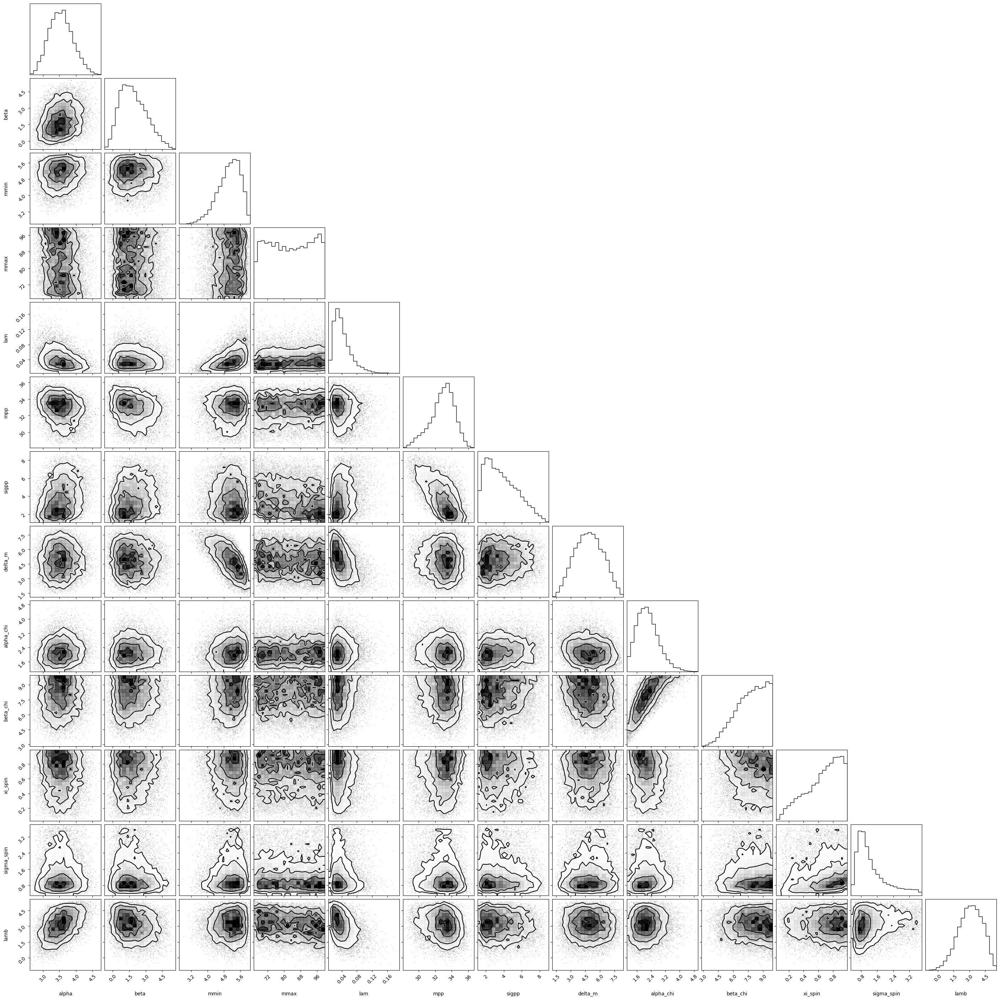

In [23]:
samples = flow.sample(jax.random.PRNGKey(1), (10_000,))
corner(np.array(samples), labels = list(prior_bounds));

## Predictive distributions

Evaluate the population model at a set of posterior samples to visualize the constrains on the population-level parameter distributions.

In [24]:
m1 = jnp.linspace(2, 100, 1_000)
m1_model = SinglePeakSmoothedMassDistribution()
m1_pdf = lambda parameters: m1_model.p_m1(
    dataset = dict(mass_1 = m1),
    alpha = parameters['alpha'],
    mmin = parameters['mmin'],
    mmax = parameters['mmax'],
    lam = parameters['lam'],
    mpp = parameters['mpp'],
    sigpp = parameters['sigpp'],
)

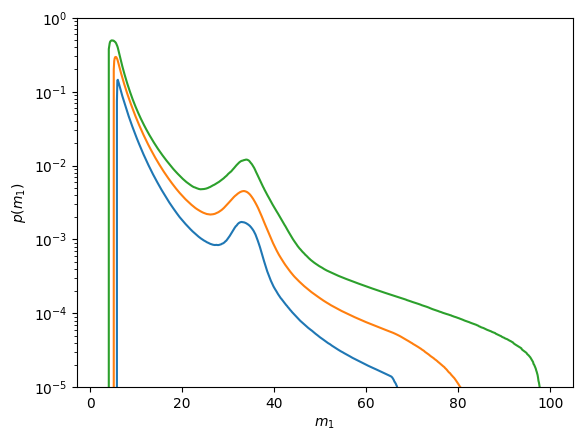

In [25]:
parameters = dict(zip(prior_bounds, samples.T))
pdfs = jax.vmap(m1_pdf)(parameters)
plt.plot(m1, np.quantile(pdfs, (0.05, 0.5, 0.95), axis = 0).T)
plt.semilogy()
plt.ylim(1e-5, 1e0)
plt.xlabel('$m_1$')
plt.ylabel('$p(m_1)$');

## Importance sampling

In [27]:
from gwax.variational import importance

In [52]:
import importlib
import gwax.variational
importlib.reload(gwax.variational)
from gwax.variational import importance

In [53]:
stats = importance(
    key = jax.random.PRNGKey(2),
    prior_bounds = prior_bounds,
    likelihood = likelihood,
    flow = flow,
    batch_size = 10_000,
)

In [56]:
stats.keys()

dict_keys(['samples', 'weights', 'log_evidence', 'log_evidence_variance', 'efficiency'])

In [55]:
print(
    f"log(evidence) = {stats['log_evidence']} "
    f"+/- {stats['log_evidence_variance']}"
)
print(f"sample efficiency = {stats['efficiency'] * 100} %")

log(evidence) = 89.88751994701788 +/- 0.0018463270524747039
sample efficiency = 5.137882653013102 %


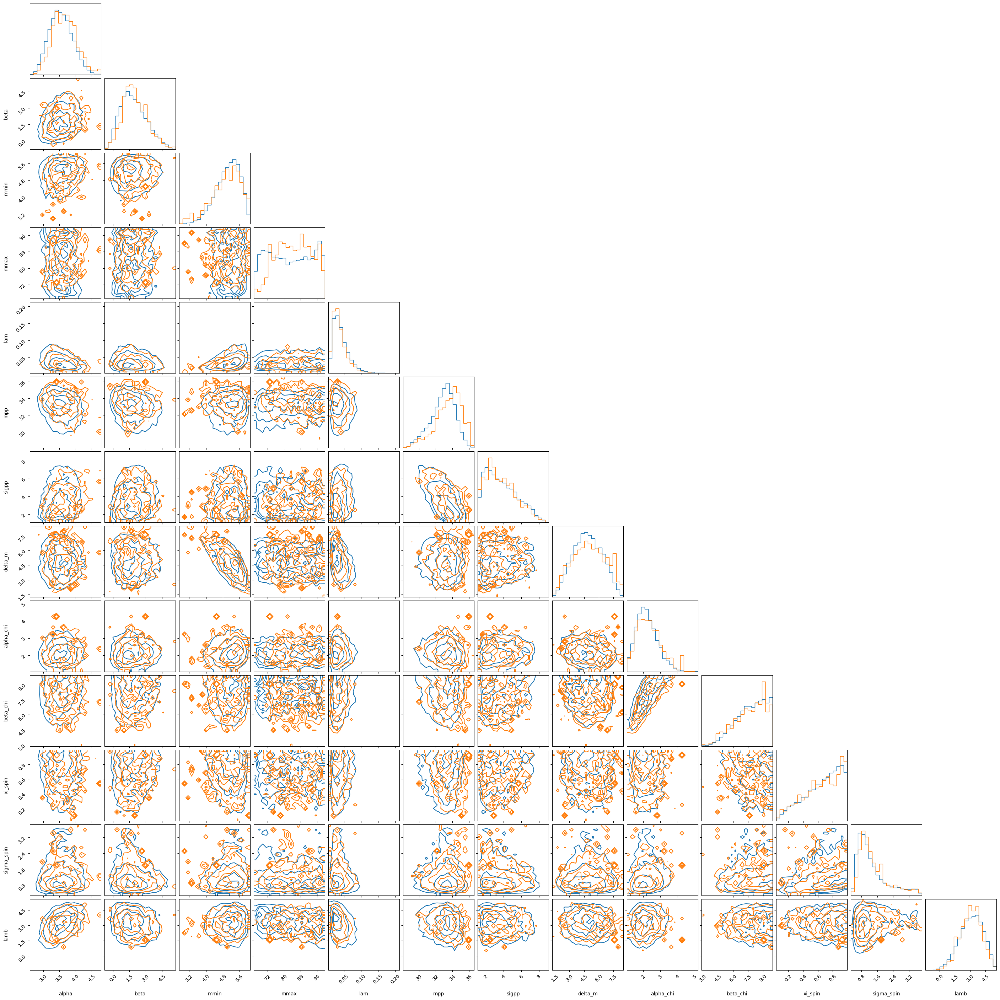

In [58]:
fig = None
for i, weights in enumerate((None, stats['weights'])):
    col = plt.get_cmap('tab10')(i)
    fig = corner(
        np.array(stats['samples']),
        weights = weights,
        labels = list(prior_bounds),
        fig = fig,
        plot_datapoints = False,
        plot_density = False,
        plot_contours = True,
        fill_contours = False,
        no_fill_contours = True,
        hist_kwargs = dict(density = True, color = col),
        contour_kwargs = dict(colors = [col]),
    )

## Custom training loop

Training the variational posterior is easily customizable using features from the [`flowjax`](https://danielward27.github.io/flowjax), [`equinox`](https://docs.kidger.site/equinox), and [`optax`](https://optax.readthedocs.io) packages. In the following we will:
- define a custom flow variational posterior,
- initialize the flow to the uniform prior before training on the population likelihood,
- alter the batch size used to compute the variational loss function,
- use a learning rate schedule,
- define a custom optimization algorithm,
- taper the population likelihood with a differentiable function to avoid regions of parameter space with large Monte Carlo uncertainties,
- temper the non-normalized target density with a temperature schedule,
- customize the progress bar.

Of course, not all of these custom options are necessary, but they illustrate what can be done.

#### Define a flow

We use the `flowjax` library for normalizing flows; see the [documentation](https://danielward27.github.io/flowjax). The support of the flow distribution is unbounded. We can include parameter constrains, e.g., prior bounds, manually with fixed transformations.

In [22]:
from flowjax.distributions import StandardNormal
from flowjax.flows import block_neural_autoregressive_flow
from gwax.flows import bound_from_unbound

In [23]:
dim = len(prior_bounds)

base_dist = StandardNormal(shape = (dim,))

flow_init = block_neural_autoregressive_flow(
    key = jax.random.PRNGKey(2),
    base_dist = base_dist,
    nn_depth = 1,
    nn_block_dim = 8,
    flow_layers = 1,
    invert = False, # BNAF is not invertible, this MUST be False
)

flow_init = bound_from_unbound(flow_init, prior_bounds.values())

Check the bounds are actually enforced. Each dimensions is contrained with a sigmoid bijection which adds a lot of support to the boundaries. This is not a good initialization, so let's choose a better one.

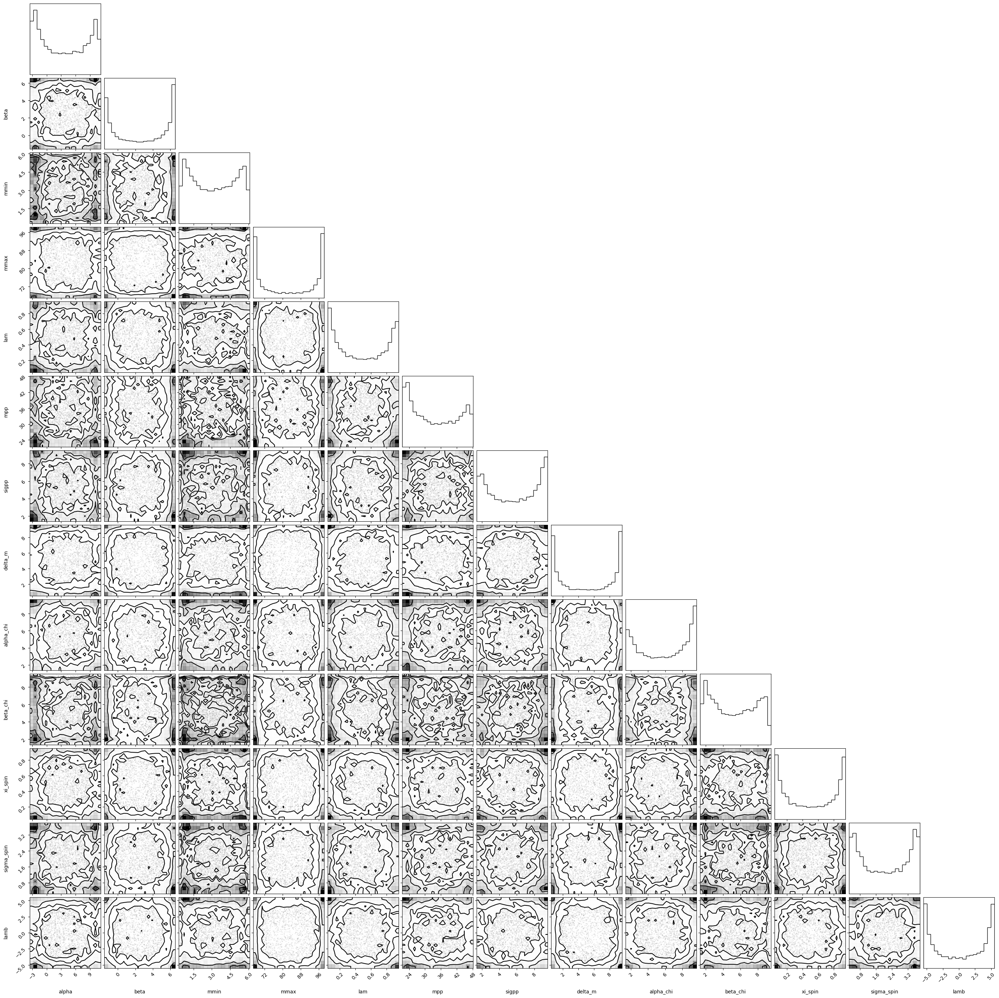

In [24]:
samples = flow_init.sample(jax.random.PRNGKey(3), (10_000,))
corner(np.array(samples), labels = list(prior_bounds));

#### Initialize the variational posterior to the prior

A sensible initialization is to start from the prior. For generic flows this cannot be done manually, but we can train the flow with a flat likelihood. As we do not have to evaluate the likelihood, calculating the loss function is quick, so let's increase the batch size.

In [25]:
flow_prior, losses = trainer(
    key = jax.random.PRNGKey(4),
    prior_bounds = prior_bounds,
    likelihood = None,
    flow = flow_init,
    batch_size = 10_000,
    steps = 1_000,
    learning_rate = 1e-2,
)

  0%|          | 0/1000 [00:00<?, ?it/s]

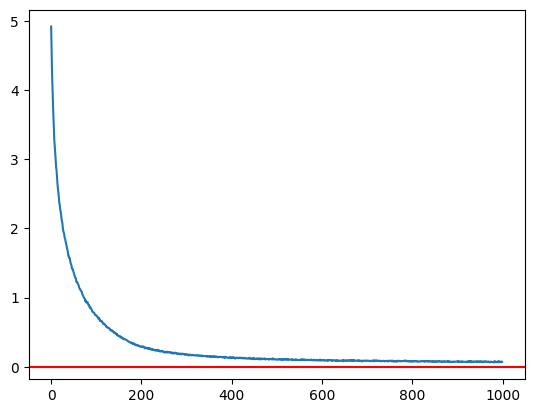

In [26]:
plt.plot(losses)
plt.axhline(0, c = 'r');

The result doesn't look quite like the uniform prior. Let's play with the training dynamics to see if we can improve it.

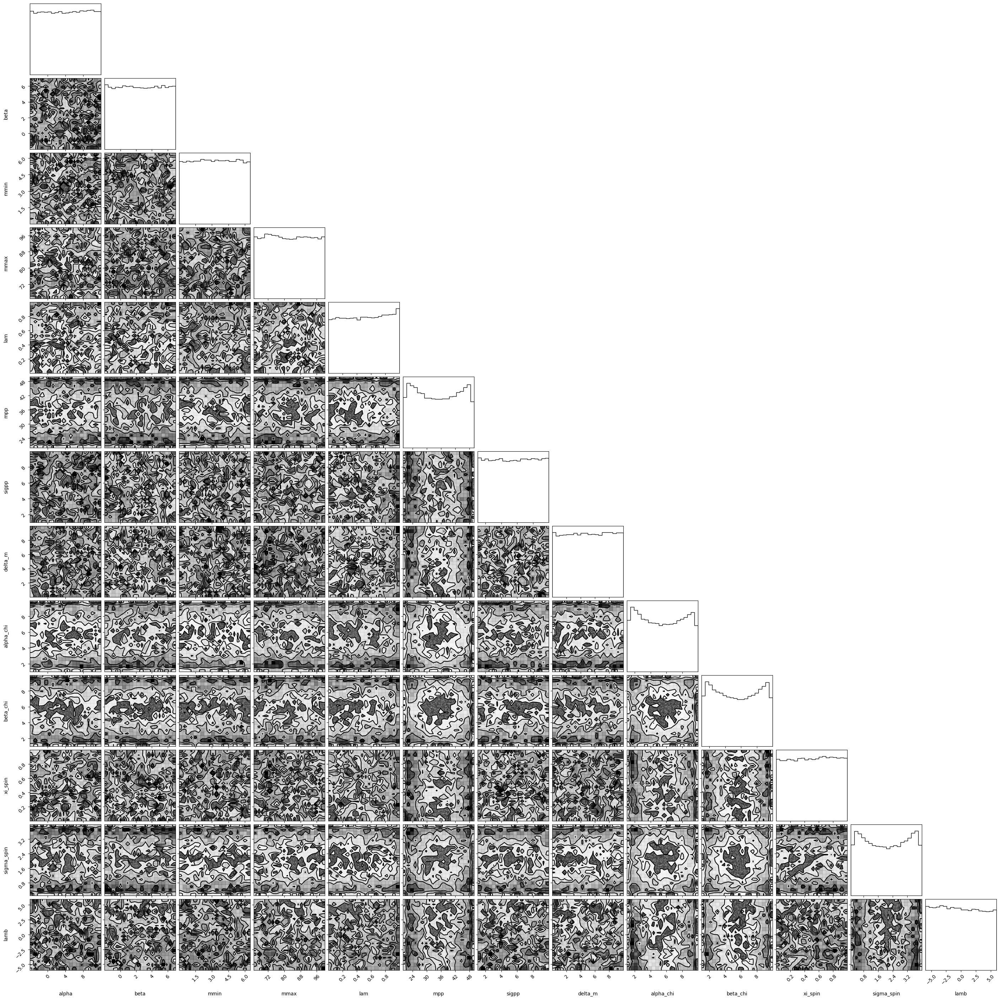

In [27]:
samples = flow_prior.sample(jax.random.PRNGKey(5), (100_000,))
corner(np.array(samples), labels = list(prior_bounds));

#### Learning rate schedule

For learning distributions like this I empirically found that starting with very a large learning rate and then decaying it was effective and leads to fast convergence. We can implement this easily using `optax`; see the [documentation](https://optax.readthedocs.io).

In [28]:
import optax

In [29]:
# very large constant learning rate for 500 steps,
# followed by cosine decay to zero learning rate.

init_learning_rate = 1e0
constant_steps = 500
total_steps = 1_000

schedules = [
    optax.constant_schedule(value = init_learning_rate),
    optax.cosine_decay_schedule(
        init_value = init_learning_rate,
        decay_steps = total_steps - constant_steps,
        alpha = 0.0,
        exponent = 1.0,
    ),
]

learning_rate = optax.join_schedules(
    schedules = schedules, boundaries = [constant_steps],
)

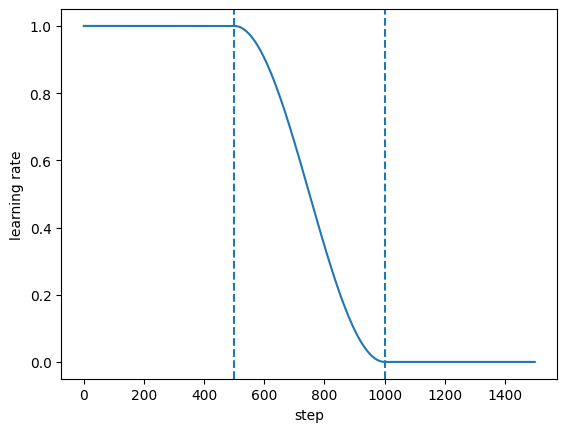

In [30]:
x = jnp.arange(total_steps + 500)
y = learning_rate(x)
plt.plot(x, y)
plt.axvline(500, ls = '--')
plt.axvline(1_000, ls = '--')
plt.xlabel('step')
plt.ylabel('learning rate');

While we're at it, let's us a custom optimizer too. `optax` is extremely flexible so you can get wild with this, but for this example let's keep it simple.

By default the `trainer` function uses the Adam optimizer, which we'll also do here, but this shows how to specific a different algorithm if you wanted to. Then let's also add some gradient clipping to make sure training is stable. This demonstrates how gradient updates can be chained together.

In [31]:
optimizer = optax.chain(
    optax.clip_by_global_norm(1.0),
    optax.adam(learning_rate),
)

In [32]:
flow_prior, losses = trainer(
    key = jax.random.PRNGKey(4), # use the same seed as before
    prior_bounds = prior_bounds,
    likelihood = None,
    flow = flow_init,
    batch_size = 10_000,
    steps = 1_000,
    # when using an instance of optax.gradientTransformation for optimizer,
    # learing_rate as no effect
    learning_rate = None,
    optimizer = optimizer,
    # instead you can use learning_rate with an uninitialized optimizer,
    # but the above allows for more flexibility
    # learning_rate = learning_rate,
    # optimizer = optax.adam,
)

  0%|          | 0/1000 [00:00<?, ?it/s]

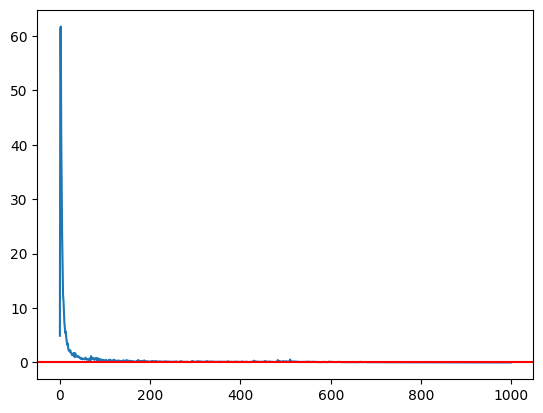

In [33]:
plt.plot(losses)
plt.axhline(0, c = 'r');

This looks more uniform:

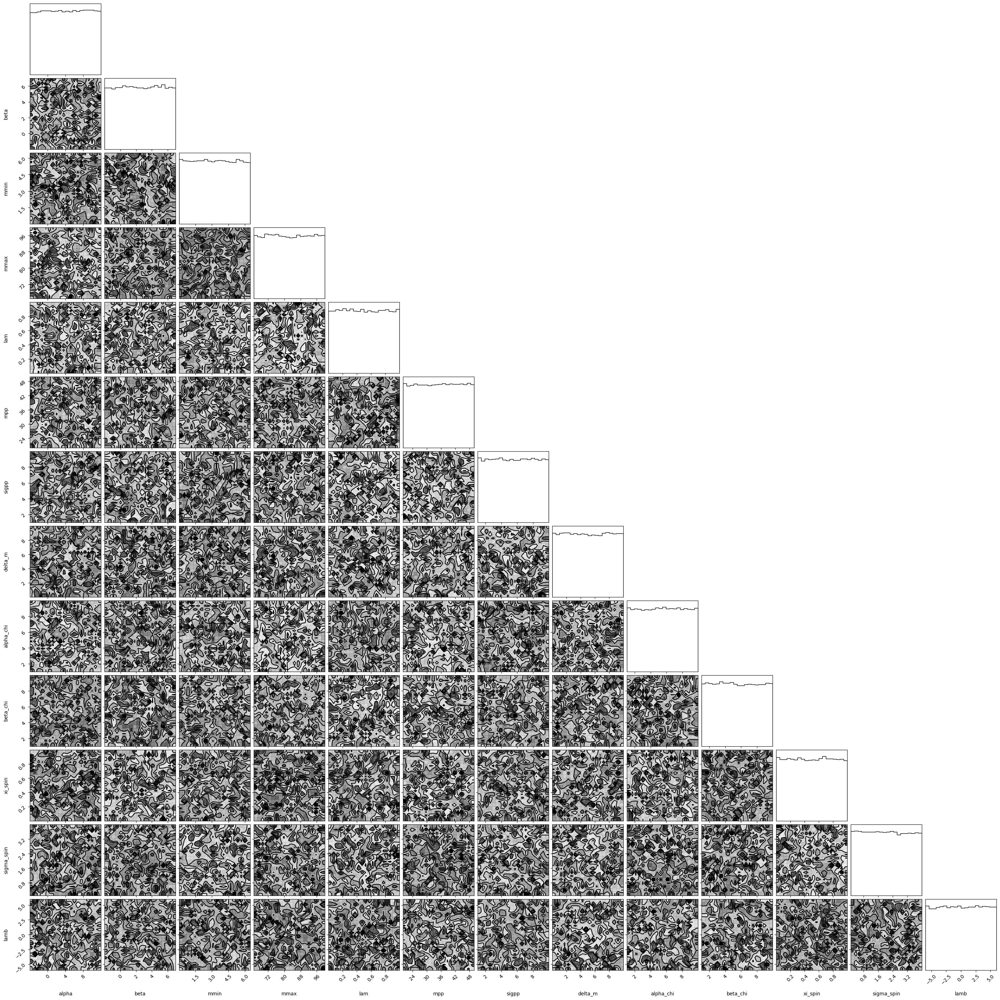

In [34]:
samples = flow_prior.sample(jax.random.PRNGKey(5), (100_000,)) # same seed
corner(np.array(samples), labels = list(prior_bounds));

#### Tapered likelihood

Now let's get back to learning the posterior. The gravitational-wave population likelihood computed in `gwpopulation` uses Monte Carlo estimators for several integrations, producing a biased estimate of the log-likelihood. This approximation carries inherent statistical uncertainty.

We can modify the likelihood ad hoc to vanish for parameters that result in large uncertaintes. We must ensure the likelihood remains differentiable with respect to the trainable parameters of the variational posterior, howver. To do this, we can defined a custom tapering function.

In [35]:
# likelihood multiplied by steep sigmoid decay to zero for variances > 1
taper = lambda variance: jax.nn.log_sigmoid(1e3 * (1 - variance))

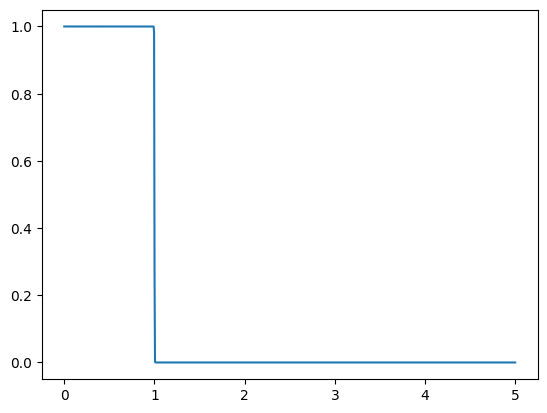

In [36]:
x = jnp.linspace(0, 5, 1_000)
y = jnp.exp(taper(x))
plt.plot(x, y);

#### Annealed posterior tempering

Tempering is a technique used to make posteriors that are difficult to sample from more tractable. The posterior $p \propto \pi \mathcal{L}$ is replaced by $(\pi \mathcal{L})^\tau$, where $\pi$ is the prior, $\mathcal{L}$ the likelihood, and $T=1/\tau$ is often called the temperature. The exponents acts to disperse the support of the posterior, which can be especially useful for multimodal targets.

During annealed tempering the temperature is varied during the course of inference, such that the tempered posterior becomes closer to the true one.

Though not necessary for the posterior in this example, we can implement a schedule for the inverse temperature $\tau=1/T$ as an illustration of how to implement custom scheules:

In [37]:
def sine_schedule(init_value, end_value, steps):
    def schedule(count):
        count = jnp.minimum(count, steps)
        sine = jnp.sin(jnp.pi * count / steps - jnp.pi / 2)
        return init_value + (1 + sine) * (end_value - init_value) / 2
    return schedule

In [38]:
# inverse temperature increases from 0 to 1 over 500 steps
temper_schedule = sine_schedule(init_value = 0.0, end_value = 1.0, steps = 500)

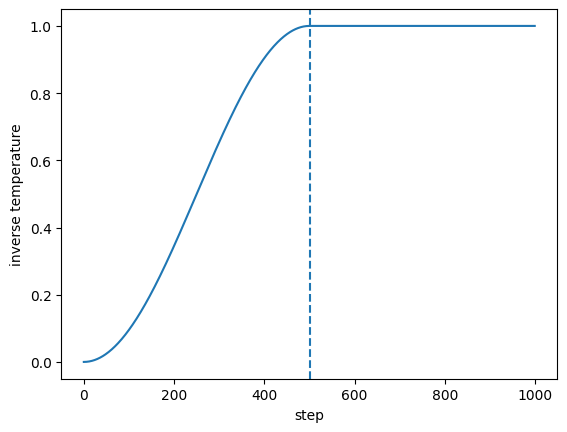

In [39]:
x = jnp.arange(total_steps)
y = temper_schedule(x)
plt.plot(x, y)
plt.axvline(500, ls = '--')
plt.xlabel('step')
plt.ylabel('inverse temperature');

#### Progress bar options

Finally, we can specify custom progress bar options, which uses [`jax-tqdm`](https://github.com/jeremiecoullon/jax-tqdm). The main one is `print_rate`, which specifies after how many steps to update the progress bar. The remaining options should be passed as a `dict` for the `tqdm_kwargs` option, which can include any options for [`tqdm`](https://tqdm.github.io); see the [documentation](https://tqdm.github.io/docs/tqdm/#tqdm-objects).

In [40]:
print_rate = 1
tqdm_kwargs = dict(desc = 'variational inference training step')

#### Train the posterior

Most of the above is not necessary, but it demonstrates how easy it is to specify custom behaviour. Now let's finally get back to learning the population posterior. Combine all these ingredients together:

In [41]:
init_learning_rate = 1e-1
constant_steps = 1_000
total_steps = 2_000

schedules = [
    optax.constant_schedule(value = init_learning_rate),
    optax.cosine_decay_schedule(
        init_value = init_learning_rate,
        decay_steps = total_steps - constant_steps,
        alpha = 0.0,
        exponent = 1.0,
    ),
]

learning_rate = optax.join_schedules(
    schedules = schedules, boundaries = [constant_steps],
)

In [42]:
import time

In [43]:
t0 = time.time()

flow, losses = trainer(
    key = jax.random.PRNGKey(6),
    prior_bounds = prior_bounds,
    likelihood = likelihood,
    flow = flow_prior, # initialize training from the learned prior
    batch_size = 10, # larger batch size than default of 1
    steps = total_steps,
    learning_rate = learning_rate,
    optimizer = optax.adam,
    taper = taper,
    temper_schedule = temper_schedule,
    print_rate = print_rate,
    tqdm_kwargs = tqdm_kwargs,
)

dt = time.time() - t0

  0%|          | 0/2000 [00:00<?, ?it/s]

In [44]:
print(f'We just did population inference in {dt} seconds')

We just did population inference in 40.51881265640259 seconds


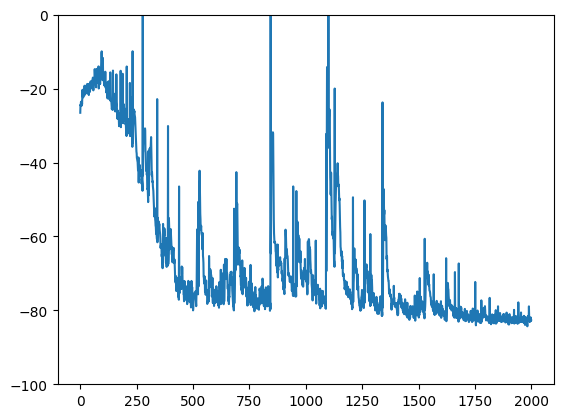

In [45]:
plt.plot(losses);
plt.ylim(-100, 0);

Notice that the maximum mass parameter `mmax` doesn't like quite right - dif

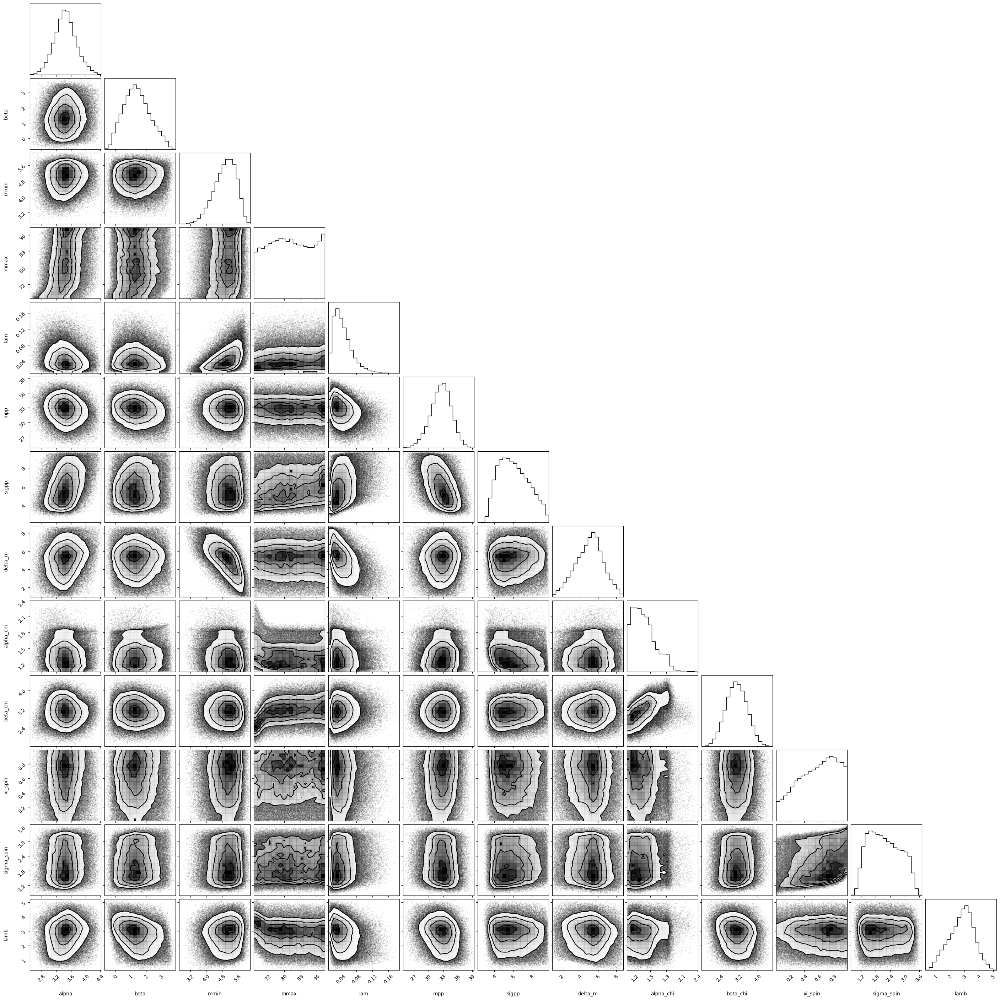

In [46]:
samples = flow.sample(jax.random.PRNGKey(7), (100_000,)) # same seed
corner(np.array(samples), labels = list(prior_bounds));

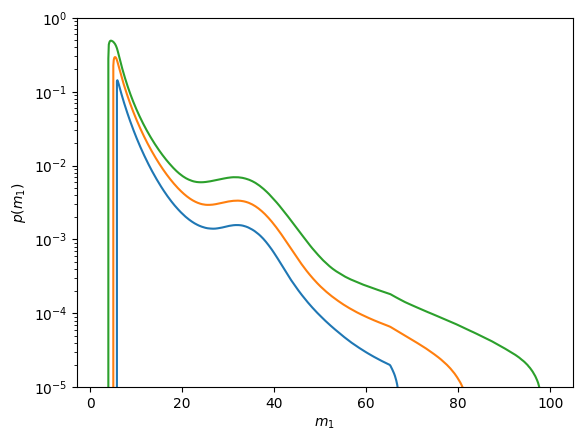

In [47]:
parameters = dict(zip(prior_bounds, samples.T))
pdfs = jax.vmap(m1_pdf)(parameters)
plt.plot(m1, np.quantile(pdfs, (0.05, 0.5, 0.95), axis = 0).T)
plt.semilogy()
plt.ylim(1e-5, 1e0)
plt.xlabel('$m_1$')
plt.ylabel('$p(m_1)$');